In [ ]:
import sys
sys.path.append('..')

import tomodpdt

import numpy as np
import time
import matplotlib.pyplot as plt

import deeplay as dl

import torch
import torch.nn as nn
from torch.utils.data import DataLoader

## 1 - Import 3D volume data

In this example we load in a 3D volume consisting of small gaussian blobs placed randomly inside the volume. The volume is 64x64x64 voxels in size, but can be up/downsampled to any size.



In [ ]:
volume = tomodpdt.VOL_GAUSS_MULT

In [ ]:
print(f"Shape of the volume: {volume.shape}")

Shape of the volume: (64, 64, 64)


In [ ]:
# Visualize the volume in 3D space - needs plotly and ipywidgets
tomodpdt.plotting.visualize_3d_volume(volume)

In [ ]:
import importlib
importlib.reload(tomodpdt.plotting)

<module 'tomodpdt.plotting' from 'c:\\Users\\fredr\\AppData\\Local\\GitHubDesktop\\app-3.4.12\\TomoDpDt\\Notebooks\\..\\tomodpdt\\plotting.py'>

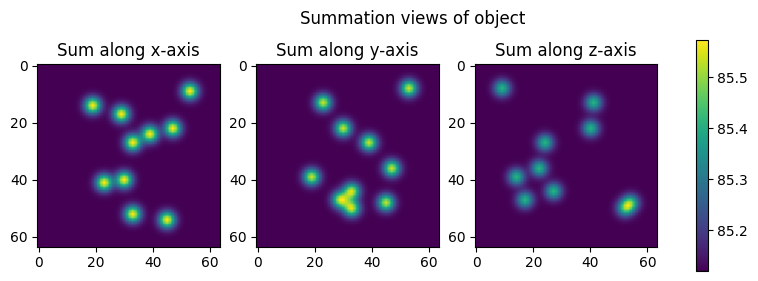

In [ ]:
tomodpdt.plotting.plot_sum_object(volume)

## 2 - Choose imaging modality
We create images that are projections of the volume along a certain axis (in this case z-axis) by taking the sum of the pixel values along that axis.

There are two main types of imaging modalities here:

- `Sum3d2d`: Sum of pixel values along an axis
- `SumAvgWeighted3d2d`: Sum of pixel values along an axis weighted by the distance from the top of the volume

In [ ]:
from tomodpdt.imaging_modality_torch import SumAvgWeighted3d2d, Sum3d2d

sum_model = Sum3d2d(dim=-1)

In [ ]:
test_object, q_gt, projections, imaging_model = tomodpdt.simulate.create_data(
    volume=volume, # The volume we want to reconstruct
    image_modality=sum_model, # We use the sum model
    rotation_case='1ax', # We rotate the object around 1 axis, x or y
    samples=200, # Number of projections
    duration=2 # Duration is the number of full revolutions
    )

Simulating... 25.0%
Simulating... 50.0%
Simulating... 75.0%


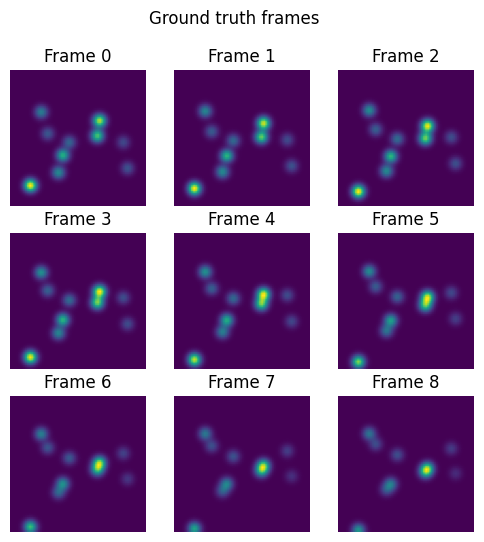

In [ ]:
fig, ax = plt.subplots(3, 3, figsize=(6, 6))
plt.suptitle("Ground truth frames")
for i in range(3):
    for j in range(3):
        ax[i, j].imshow(projections[i * 3 + j, 0])
        ax[i, j].set_title(f'Frame {i * 3 + j}')
        ax[i, j].axis('off')

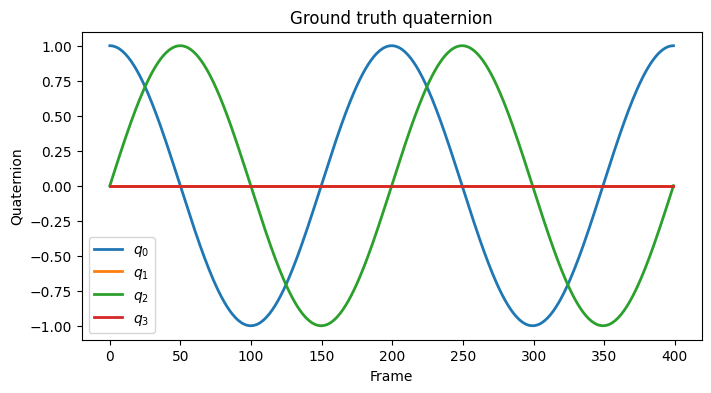

In [ ]:
plt.figure(figsize=(8, 4))
plt.plot(q_gt[:, 0].cpu(), label=r'$q_0$', linewidth=2)
plt.plot(q_gt[:, 1].cpu(), label=r'$q_1$', linewidth=2)
plt.plot(q_gt[:, 2].cpu(), label=r'$q_2$', linewidth=2)
plt.plot(q_gt[:, 3].cpu(), label=r'$q_3$', linewidth=2)
plt.legend()
plt.xlabel('Frame')
plt.ylabel('Quaternion')
plt.title('Ground truth quaternion')
plt.show()

## 3 - Tomographic reconstruction

### 3.1 - Set up the tomographic reconstruction class

In [ ]:
N=volume.shape[0]

# Create the tomography model
tomo = tomodpdt.Tomography(
    volume_size=(N, N, N), # The size of the volume
    initial_volume='refraction', # 'refraction' since we are optimizing the refractive index
    rotation_optim_case='basis', # 'basis' or 'quaternion'
    imaging_model=sum_model, # The imaging model
    )


### 3.2 - Initialize the parameters by producing a initial guess for the rotation parameters and the volume

In [ ]:
# Initialize the parameters
tomo.initialize_parameters(projections, normalize=True)

c:\Users\fredr\miniconda3\envs\torchenv\Lib\site-packages\lightning\pytorch\trainer\configuration_validator.py:74: PossibleUserWarning:

You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.


  | Name                | Type                 | Params
-------------------------------------------------------------
0 | encoder             | Sequential           | 79.5 K
1 | fc_mu               | MultiLayerPerceptron | 32.8 K
2 | fc_var              | MultiLayerPerceptron | 32.8 K
3 | fc_dec              | MultiLayerPerceptron | 51.3 K
4 | decoder             | Sequential           | 61.0 K
5 | reconstruction_loss | BCELoss              | 0     
6 | train_metrics       | MetricCollection     | 0     
7 | val_metrics         | MetricCollection     | 0     
8 | test_metrics        | MetricCollection     | 0     
9 | optimizer           | Adam                 | 0     
-------------------------------------------------------------
257 K     Trainable params
0         Non

Epoch 0:   0%|          | 0/13 [00:00<?, ?it/s] 

c:\Users\fredr\miniconda3\envs\torchenv\Lib\site-packages\torch\autograd\graph.py:744: UserWarning:

Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\cudnn\Conv_v8.cpp:919.)



Epoch 249: 100%|██████████| 13/13 [00:00<00:00, 50.79it/s, v_num=40, train_rec_loss_step=4.1e+3, train_KL_step=189.0, train_total_loss_step=4.1e+3, train_rec_loss_epoch=7.97e+3, train_KL_epoch=374.0, train_total_loss_epoch=7.98e+3]    


In [ ]:
import importlib
importlib.reload(tomodpdt.plotting)

<module 'tomodpdt.plotting' from 'c:\\Users\\fredr\\AppData\\Local\\GitHubDesktop\\app-3.4.12\\TomoDpDt\\Notebooks\\..\\tomodpdt\\plotting.py'>

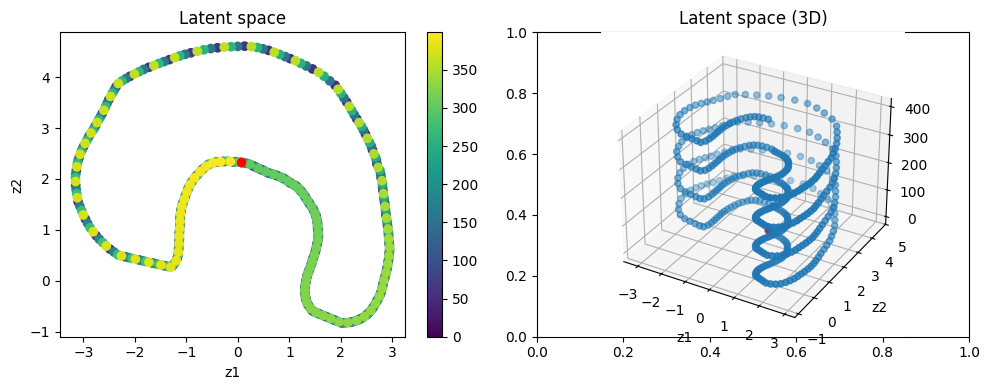

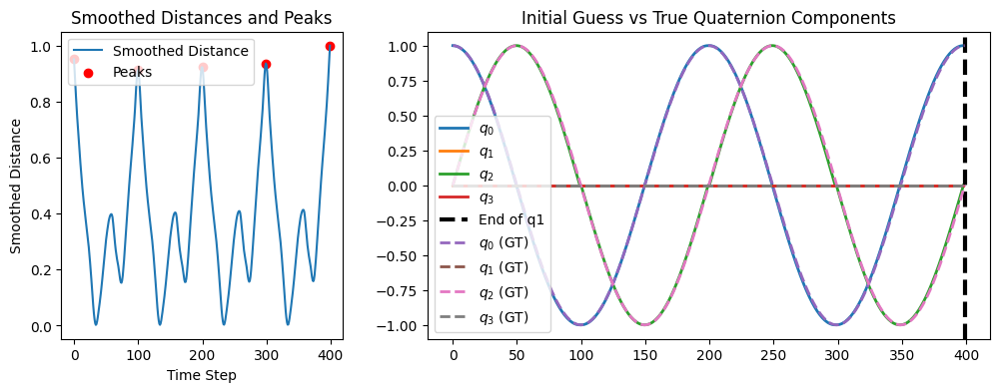

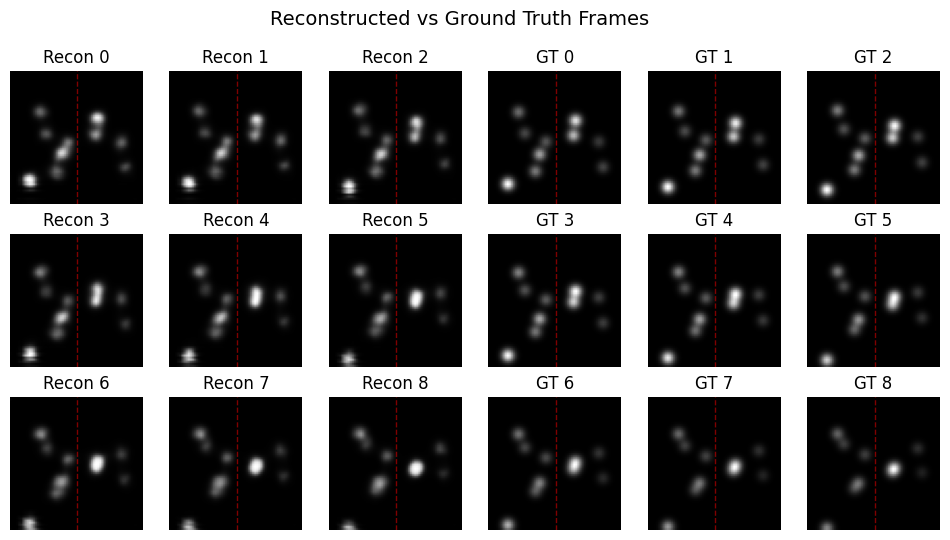

In [ ]:
tomodpdt.plotting.plots_initial(tomo, gt=q_gt.to('cpu'))

### 3.3 - Validate that the initial rotation parameters are correct

In [ ]:
N = len(tomo.frames) # Number of frames
idx = torch.arange(N) # Index of frames

In [ ]:
# Toggle the gradients rotation params to off for initial phase
tomo.toggle_gradients_quaternion(False)

# First axis test.
trainer = dl.Trainer(max_epochs=10, accelerator="auto", log_every_n_steps=10)
trainer.fit(tomo, DataLoader(idx, batch_size=64, shuffle=True))
loss1 = trainer.callback_metrics['train_total_loss_epoch'].item()
vol1 = tomo.volume.clone()
rot1 = tomo.rotation_params.clone()    

# Swap the rotation axis.
tomo.swap_rotation_axis()
tomo.initialize_volume() # Reinitialize the volume
tomo.move_all_to_device("cuda") 
trainer = dl.Trainer(max_epochs=10, accelerator="auto", log_every_n_steps=10)
trainer.fit(tomo, DataLoader(idx, batch_size=64, shuffle=True))
loss2 = trainer.callback_metrics['train_total_loss_epoch'].item()
vol2 = tomo.volume.clone()
rot2 = tomo.rotation_params.clone()

# Choose the best loss and proceed with that.
if loss1 < loss2:
    print("Loss 1 is better ie. choose optimized axis", loss1, loss2)
    tomo.volume = nn.Parameter(vol1)
    tomo.rotation_params = nn.Parameter(rot1)
else:
    del vol1, rot1, loss1, vol2, rot2, loss2

c:\Users\fredr\miniconda3\envs\torchenv\Lib\site-packages\lightning\pytorch\trainer\configuration_validator.py:74: PossibleUserWarning:

You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.


  | Name          | Type                   | Params
---------------------------------------------------------
0 | vae_model     | VariationalAutoEncoder | 257 K 
1 | encoder       | Sequential             | 79.5 K
2 | fc_mu         | MultiLayerPerceptron   | 32.8 K
3 | imaging_model | SumAvgWeighted3d2d     | 0     
4 | train_metrics | MetricCollection       | 0     
5 | val_metrics   | MetricCollection       | 0     
6 | test_metrics  | MetricCollection       | 0     
7 | optimizer     | Adam                   | 0     
  | other params  | n/a                    | 149 K 
---------------------------------------------------------
262 K     Trainable params
257 K     Non-trainable params
519 K     Total params
2.079     Total estimated model params size (MB)
c:\Users\fredr

Epoch 9: 100%|██████████| 7/7 [00:00<00:00, 21.64it/s, v_num=41, train_proj_loss_step=0.048, train_latent_loss_step=0.0317, train_rtv_loss_step=0.000699, train_qv_loss_step=0.000449, train_q0_loss_step=0.000, train_rtr_loss_step=0.000, train_so_loss_step=0.00014, train_total_loss_step=0.081, train_proj_loss_epoch=0.0502, train_latent_loss_epoch=0.0203, train_rtv_loss_epoch=0.000705, train_qv_loss_epoch=0.000388, train_q0_loss_epoch=0.00815, train_rtr_loss_epoch=0.000, train_so_loss_epoch=0.000142, train_total_loss_epoch=0.0799]   



  | Name          | Type                   | Params
---------------------------------------------------------
0 | vae_model     | VariationalAutoEncoder | 257 K 
1 | encoder       | Sequential             | 79.5 K
2 | fc_mu         | MultiLayerPerceptron   | 32.8 K
3 | imaging_model | SumAvgWeighted3d2d     | 0     
4 | train_metrics | MetricCollection       | 0     
5 | val_metrics   | MetricCollection       | 0     
6 | test_metrics  | MetricCollection       | 0     
7 | optimizer     | Adam                   | 0     
  | other params  | n/a                    | 149 K 
---------------------------------------------------------
262 K     Trainable params
257 K     Non-trainable params
519 K     Total params
2.079     Total estimated model params size (MB)


Epoch 9: 100%|██████████| 7/7 [00:00<00:00, 19.50it/s, v_num=42, train_proj_loss_step=0.221, train_latent_loss_step=0.481, train_rtv_loss_step=0.000915, train_qv_loss_step=0.000377, train_q0_loss_step=0.000, train_rtr_loss_step=0.000, train_so_loss_step=0.000402, train_total_loss_step=0.703, train_proj_loss_epoch=0.217, train_latent_loss_epoch=0.431, train_rtv_loss_epoch=0.000901, train_qv_loss_epoch=0.000388, train_q0_loss_epoch=0.00815, train_rtr_loss_epoch=0.000, train_so_loss_epoch=0.000399, train_total_loss_epoch=0.658] 
Loss 1 is better ie. choose optimized axis 0.07993897795677185 0.6584858894348145


### 3.4 - Optimize the 3D volume and the rotation parameters

In [ ]:
# Toggle the gradients of the quaternion parameters
tomo.toggle_gradients_quaternion(True)

# Move the model to the GPU
tomo.move_all_to_device("cuda")

# Train the model
start_time = time.time()
trainer = dl.Trainer(max_epochs=500, accelerator="auto", log_every_n_steps=10)
trainer.fit(tomo, DataLoader(idx, batch_size=128, shuffle=False))
print("Training time: ", (time.time() - start_time) / 60, " minutes")

# Plot the training history
try:
    trainer.history.plot()
except:
    print("No history to plot...")


  | Name          | Type                   | Params
---------------------------------------------------------
0 | vae_model     | VariationalAutoEncoder | 257 K 
1 | encoder       | Sequential             | 79.5 K
2 | fc_mu         | MultiLayerPerceptron   | 32.8 K
3 | imaging_model | SumAvgWeighted3d2d     | 0     
4 | train_metrics | MetricCollection       | 0     
5 | val_metrics   | MetricCollection       | 0     
6 | test_metrics  | MetricCollection       | 0     
7 | optimizer     | Adam                   | 0     
  | other params  | n/a                    | 149 K 
---------------------------------------------------------
262 K     Trainable params
257 K     Non-trainable params
519 K     Total params
2.079     Total estimated model params size (MB)
c:\Users\fredr\miniconda3\envs\torchenv\Lib\site-packages\lightning\pytorch\loops\fit_loop.py:298: PossibleUserWarning:

The number of training batches (4) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a low

Epoch 499: 100%|██████████| 4/4 [00:00<00:00,  4.74it/s, v_num=43, train_proj_loss_step=0.0924, train_latent_loss_step=0.0312, train_rtv_loss_step=0.000748, train_qv_loss_step=0.000132, train_q0_loss_step=0.000, train_rtr_loss_step=0.000829, train_so_loss_step=0.000219, train_total_loss_step=0.126, train_proj_loss_epoch=0.0903, train_latent_loss_epoch=0.0186, train_rtv_loss_epoch=0.000748, train_qv_loss_epoch=0.00131, train_q0_loss_epoch=5.08e-5, train_rtr_loss_epoch=0.000979, train_so_loss_epoch=0.000231, train_total_loss_epoch=0.112]    
Training time:  7.098376131057739  minutes
No history to plot...


## 4.0 - Visualize the reconstructed volume and the parameters

In [ ]:
importlib.reload(tomodpdt.plotting)

<module 'tomodpdt.plotting' from 'c:\\Users\\fredr\\AppData\\Local\\GitHubDesktop\\app-3.4.12\\TomoDpDt\\Notebooks\\..\\tomodpdt\\plotting.py'>

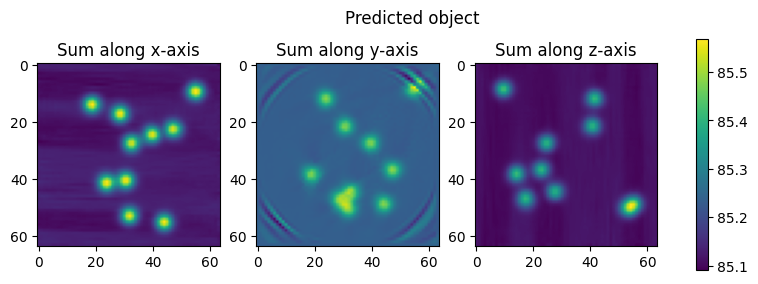

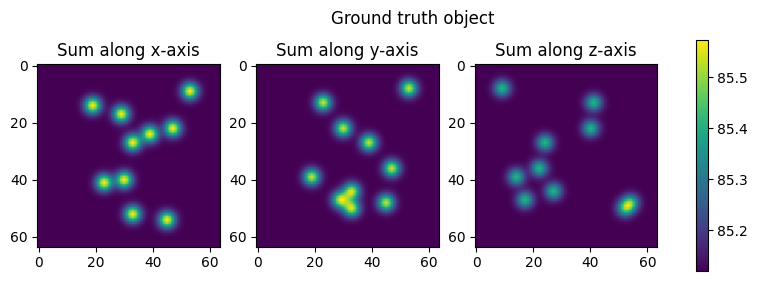

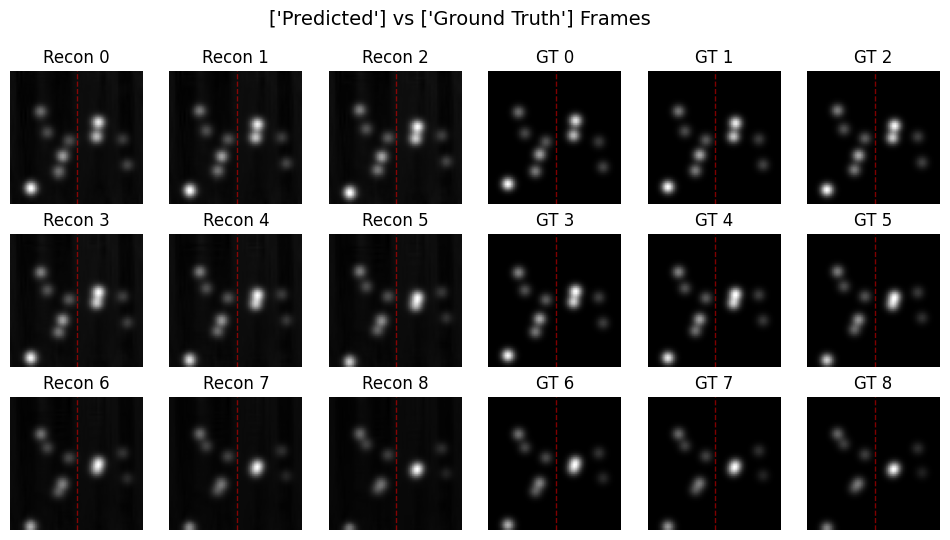

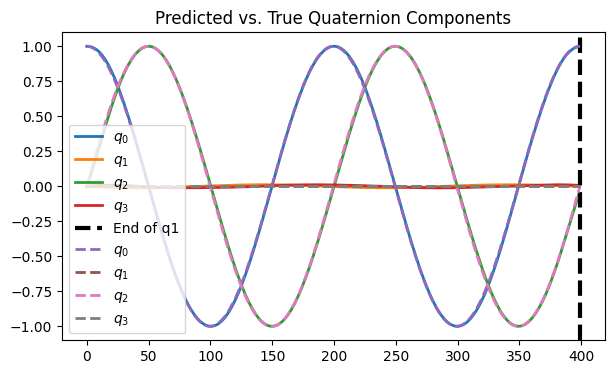

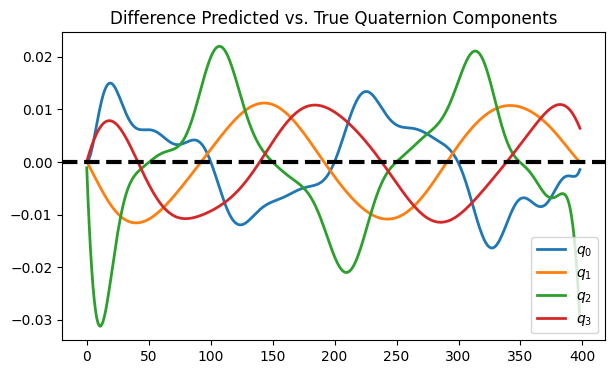

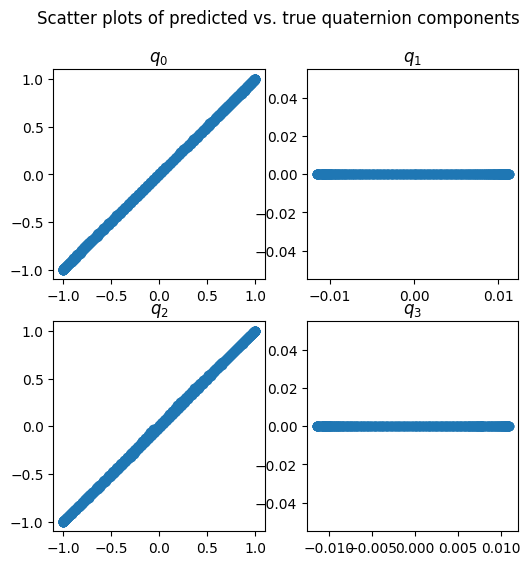

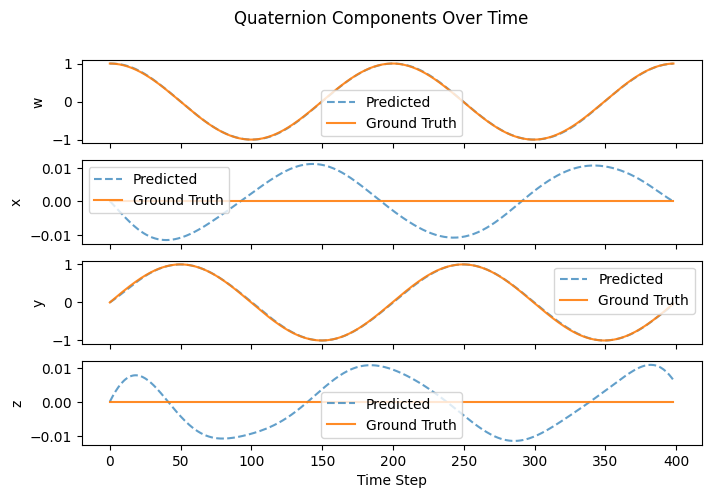

In [ ]:
# Move it to the GPU if possible for faster plotting
tomo.move_all_to_device("cuda")

# Visualize the final volume and rotations.
tomodpdt.plotting.plots_optim(tomo, gt_q=q_gt.to('cpu'), gt_v=test_object.to('cpu'), dpi=250)

In [ ]:
import importlib
importlib.reload(tomodpdt.plotting)

<module 'tomodpdt.plotting' from 'c:\\Users\\fredr\\AppData\\Local\\GitHubDesktop\\app-3.4.12\\TomoDpDt\\Notebooks\\..\\tomodpdt\\plotting.py'>

## 5 - Save the reconstructed volume and the parameters